<a href="https://colab.research.google.com/github/JCCamelo/MVP2_PUC_RIO/blob/main/MVP_Deep_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1 - Introdução

O dataset baixado para este estudo foi extraído da plataforma Kaggle e pode ser encontrado [aqui](https://www.kaggle.com/datasets/sanikamal/horses-or-humans-dataset). Nele, estão presentes algumas imagens separadas em 2 grupos, cavalos e humanos. O objetivo deste estudo é fazer um modelo que consiga classificar as imagens nos respectivos grupos corretamente.

# 2 - Importação das Bibliotecas

Instalação das bibliotecas para que o notebook consiga ser executado.

In [1]:
!pip install tensorflow

!pip install keras

!pip install pandas

!pip install scikit-learn

In [2]:
!pip install gdown
import gdown
import os
import zipfile

In [3]:
%matplotlib inline
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import torch.backends.cudnn as cudnn
import numpy as np
import torchvision
from torchvision import datasets, models
import torchvision.transforms as T
from torch.utils.data import Dataset, DataLoader
from torchvision.utils import make_grid
from torchsummary import summary
import matplotlib.pyplot as plt
import requests
import pandas as pd
from io import BytesIO
import time
import os
from PIL import Image
from tempfile import TemporaryDirectory
import pickle
cudnn.benchmark = True
import seaborn as sn
import matplotlib.image as mpimg
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import models, layers
import sklearn.metrics as skm
from sklearn.metrics import confusion_matrix
import itertools
from datetime import datetime
import tensorflow.keras as keras

plot_confusion_matrix é uma função python que imprime uma matriz de confusão

In [4]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    Esta função imprime e plota a matriz de confusão.
    A normalização pode ser aplicada definindo `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Matriz de confusão normalizada")
    else:
        print('Matriz de confusão sem normalização')

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('Label real')
    plt.xlabel('Label predito')

# 3 - Tratamento de dados

Importanto o arquivo que contém as imagens que está em um Google Drive

In [5]:
file_id = "1efGx_n8hPJ-ZfNTSkonsRYJHDjH9mAC9"
url = f"https://drive.google.com/uc?id={file_id}"

folder_path = "./dataset"  # especifique a pasta onde baixara o arquivo
os.makedirs(folder_path, exist_ok=True) # cria a pasta de destino se necessário

output = "dataset/train.zip"  # especifique o nome do arquivo e a extensão do mesmo
gdown.download(url, output)

Downloading...
From: https://drive.google.com/uc?id=1efGx_n8hPJ-ZfNTSkonsRYJHDjH9mAC9
To: /content/dataset/train.zip
100%|██████████| 150M/150M [00:01<00:00, 97.0MB/s]


'dataset/train.zip'

Extraindo o arquivo .zip

In [6]:
# Path onde se encontra o arquivo 'train.zip'
train = 'dataset/train.zip'
destination = 'datasets/train_images/'

# Criando a pasta de destino se necessário
os.makedirs(destination,exist_ok=True)

with zipfile.ZipFile(train,'r') as zip_ref:
    zip_ref.extractall(destination)

Verificando a pasta que foi extraída do .zip

In [7]:
r='datasets/train_images'
print(os.listdir(r))

['train']


Verificando o número de imagens que foram extraídas

In [8]:
path='datasets/train_images/train/'
print(f"Temos um total de {len(os.listdir(path))} imagens para o treinamento e avaliação do modelo de deep learning")

Temos um total de 1027 imagens para o treinamento e avaliação do modelo de deep learning


Exemplos de algumas imagens extraídas

In [9]:
print(f"Primeiras 20 imagens: \n {os.listdir(path)[:20]}")

Primeiras 20 imagens: 
 ['horse33-2.png', 'human08-20.png', 'horse32-7.png', 'horse36-6.png', 'horse27-5.png', 'horse25-3.png', 'human09-01.png', 'human16-27.png', 'horse45-8.png', 'human06-10.png', 'horse08-7.png', 'horse20-8.png', 'horse13-7.png', 'horse12-1.png', 'human07-22.png', 'horse18-3.png', 'horse37-1.png', 'horse02-2.png', 'horse43-9.png', 'horse12-9.png']


Criando um dataframe com as informações das imagens

In [10]:
images =os.listdir(path)

labels, heights, widths, channels, filesize = [], [], [], [], []

# Loop que percorre cada uma das imagens extraídas
for fname in images:

    labels.append(str(fname)[:5])
    img_shape = mpimg.imread(path+fname).shape
    heights.append(img_shape[0])
    widths.append(img_shape[1])
    channels.append(img_shape[2])
    filesize.append(os.path.getsize(path+fname))

# Criação do dataset
df = pd.DataFrame({'images': images, 'class': labels, 'height': heights,
                         'width': widths, 'channels': channels, 'filesize': filesize})

Visualização do dataset criado

In [11]:
df.head()

,images,class,height,width,channels,filesize
0,horse33-2.png,horse,300,300,4,167540
1,human08-20.png,human,300,300,4,151583
2,horse32-7.png,horse,300,300,4,151753
3,horse36-6.png,horse,300,300,4,135000
4,horse27-5.png,horse,300,300,4,165960


Visualização do número de imagens por classe, há 27 imagens de humanos a mais que a de cavalos

human    527
horse    500
Name: class, dtype: int64


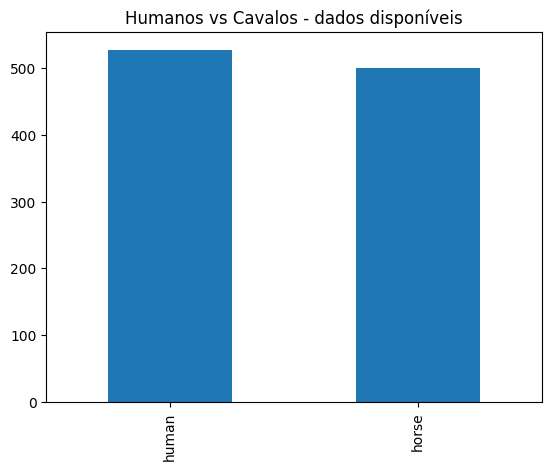

In [12]:
print((df['class']).value_counts())
dogsVScats_count = df['class'].value_counts().plot.bar(title='Humanos vs Cavalos - dados disponíveis')

Visualizando algumas imagens do conjunto de dados

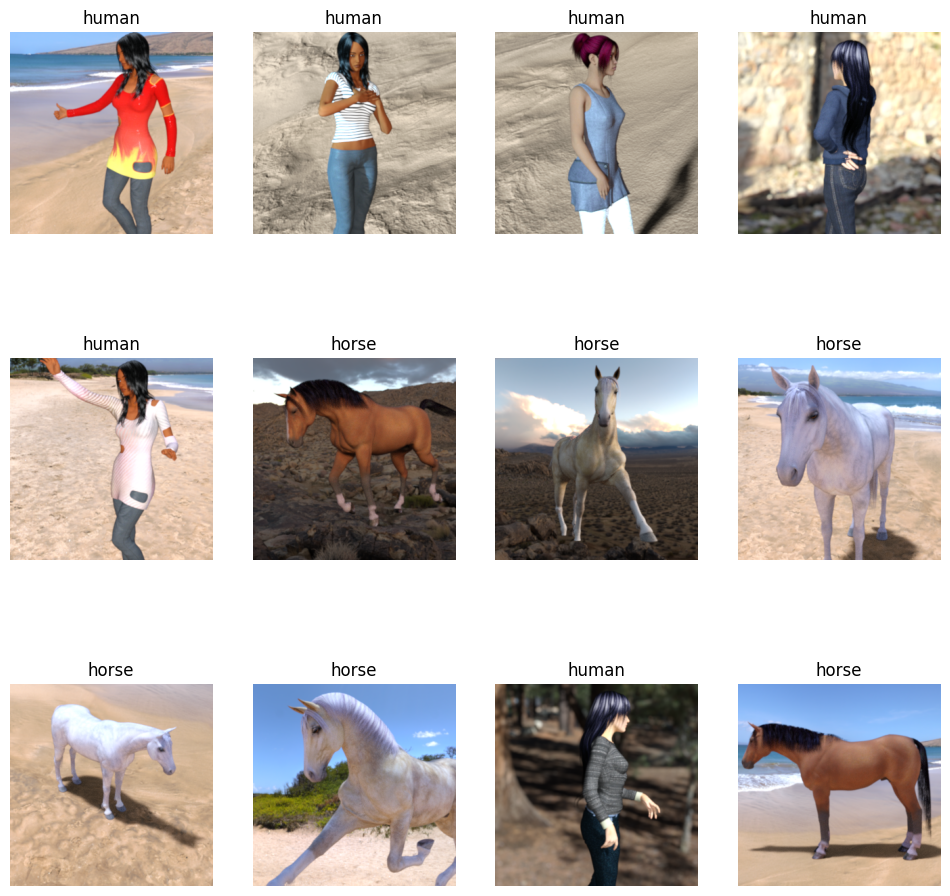

In [13]:
fig = plt.gcf()
fig.set_size_inches(3*4, 3*4)

# Visualizando apenas 12 imagens
for i in range(12):

    sample = np.random.choice(images)
    img_path =path+sample
    sp = plt.subplot(3, 4, i + 1)
    sp.axis('Off')
    img = mpimg.imread(img_path)
    plt.imshow(img)
    plt.title(sample[:5])

plt.show()

Dividimos os dados em 30% para teste e 70% para treinamento do modelo

In [14]:
train, test =train_test_split(df[['images' , 'class']] ,test_size=0.3 ,random_state=42 , shuffle=True)

Visualizando a divisão dos dados

In [15]:
print("##### Train: #####")
print(train)
print("##### Test: #####")
print(test)

##### Train: #####
             images  class
534  human15-04.png  human
827  human02-29.png  human
239  human16-18.png  human
319  human16-30.png  human
211  human01-16.png  human
..              ...    ...
330  human13-21.png  human
214  human15-01.png  human
466  human17-01.png  human
121  human03-03.png  human
860  human02-20.png  human

[718 rows x 2 columns]
##### Test: #####
             images  class
428  human04-20.png  human
533   horse36-2.png  horse
388   horse39-3.png  horse
107   horse11-1.png  horse
423   horse10-3.png  horse
..              ...    ...
968  human08-08.png  human
196  human05-01.png  human
629  human12-06.png  human
81   human08-15.png  human
679  human06-04.png  human

[309 rows x 2 columns]


Utilizamos ainda o ImageDataGenerator para separar um conjunto de validação com 20% das amostras do conjunto de treino. É importante que o conjunto de validação não contenha as imagens de teste, tendo em vista que elas não deveriam ser conhecidas no momento do treinamento.

Usamos o método flow_from_dataframe() para gerar imagens aumentadas a partir de um dataframe que aponta para as imagens originais. O método recebe parâmetros como o dataframe, o diretório com as imagens, o tamanho do lote (batch size) e o modo de classe (neste caso, binário porque são apenas duas classes), entre outros.

Fazemos isso para aumentar a quantidade de imagens, colocando-as de diversas maneiras, pro lado esquerdo, direito, com zoom, para que o treino possa ter várias alternativas e quando chegar no modelo de teste ele consiga rodar da melhor maneira possível.

In [16]:
train_datagen=ImageDataGenerator(validation_split=0.2, #include validation split
                                 rescale = 1.0/255,
                                    rotation_range=40,
                                    shear_range=0.2,
                                    zoom_range=0.2,
                                    horizontal_flip=True,
                                    fill_mode='nearest')

test_datagen=ImageDataGenerator(rescale=1./255)


train_generator=train_datagen.flow_from_dataframe(
    train ,path,
    target_size=(150,150),
    batch_size=50,
    class_mode='binary',
    x_col='images',
    y_col='class',
    subset='training' #training set
    )

val_generator=train_datagen.flow_from_dataframe(
    train ,path,
    target_size=(150,150),
    batch_size=50,
    class_mode='binary',
    x_col='images',
    y_col='class',
    subset='validation' #validation set
    )

test_generator=test_datagen.flow_from_dataframe(
    test ,path,
    target_size=(150,150),
    batch_size=50,
    class_mode='binary',
    x_col='images',
    y_col='class',)

Found 575 validated image filenames belonging to 2 classes.
Found 143 validated image filenames belonging to 2 classes.
Found 309 validated image filenames belonging to 2 classes.


Visualizando um exemplo do tratamento das imagens

Found 1 validated image filenames belonging to 1 classes.


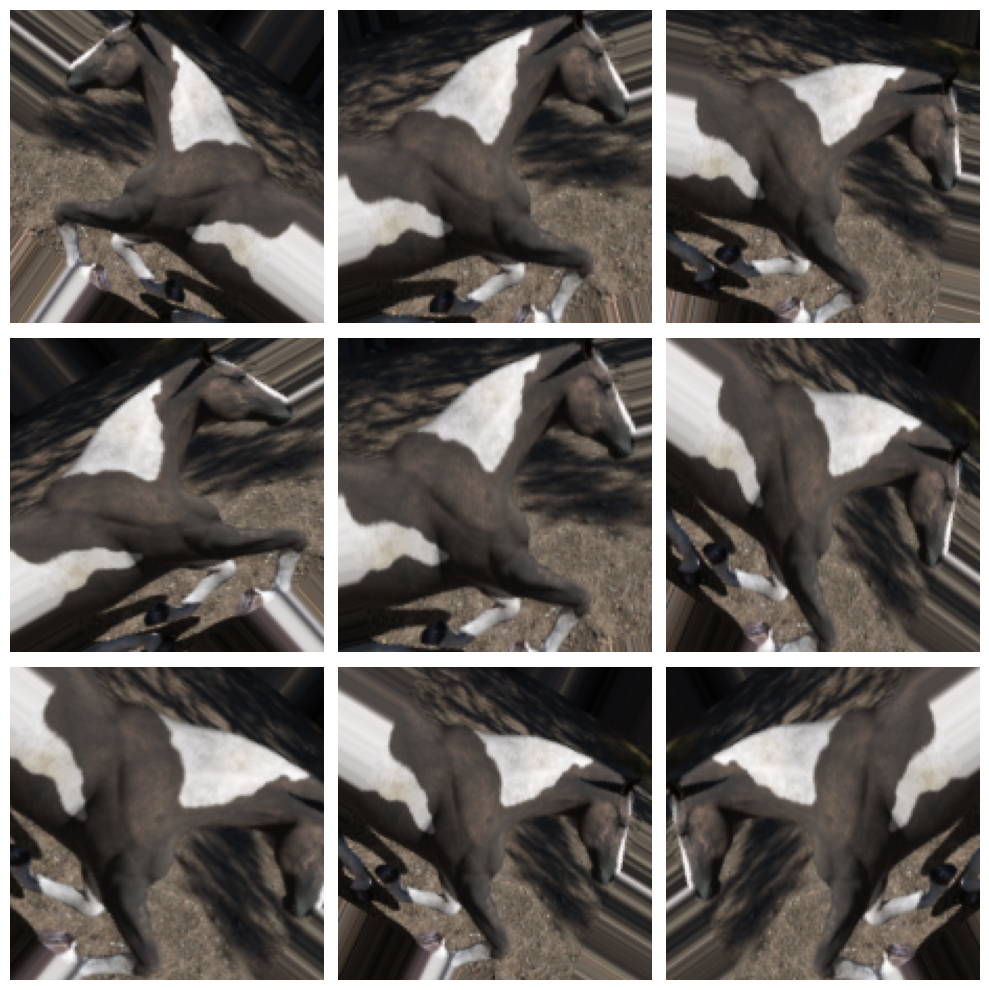

In [17]:
# Pegando um registro do dataframe
sample = df.sample(n=1)

# Neste caso o tipo de classe é categorico, pois temos um exemplo com apenas uma classe
sample_generator = train_datagen.flow_from_dataframe(
    sample,
    path,
    x_col='images',
    y_col='class',
    target_size=(150,150),
    class_mode='categorical'
)

plt.figure(figsize=(10, 10))
for i in range(9):
    plt.subplot(3, 3, i+1)
    for x_batch, y_batch in sample_generator:
        image = x_batch[0]
        plt.imshow(image)
        plt.axis('Off')
        break
plt.tight_layout()
plt.show()

# 4 - Configuração do modelo de Deep Learning

Aqui é especificada uma camada convolucional 2D que possui 32 filtros, um tamanho de filtro de 3x3 que usa a função de ativação ReLU. O parâmetro input_shape define a forma das imagens de entrada para a rede.

In [18]:
model=models.Sequential()
model.add(layers.Conv2D(32 ,(3,3) , activation='relu' , input_shape=(150,150,3 ) ) )
model.add(layers.MaxPooling2D( (2,2)))

model.add(layers.Conv2D(64 , (3,3) , activation='relu'))
model.add(layers.MaxPooling2D( (2,2)))

model.add(layers.Conv2D(128 , (3,3) , activation='relu'))
model.add(layers.MaxPooling2D( (2,2)))

model.add(layers.Conv2D(128 , (3,3) , activation='relu'))
model.add(layers.MaxPooling2D( (2,2)))

Na sequência são adicionadas camadas max-pooling com a mesma função de ativação.

In [19]:
model.add(layers.Flatten() )
model.add(layers.Dropout(0.25))
model.add(layers.Dense( 512 ,activation='relu' ))
model.add(layers.Dropout(0.25))
model.add(layers.Dense( 1 , activation='sigmoid' ) )

O método summary() é usado para exibir um resumo da arquitetura do modelo de rede neural. Ele fornece uma representação compacta das camadas do modelo e seus parâmetros, incluindo o número de parâmetros treináveis e a forma de saída de cada camada.

In [20]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 74, 74, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 36, 36, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 17, 17, 128)      0

# 4 - Treinamento do modelo de deep learning

optimizer='adam': especifica o otimizador a ser usado durante o treinamento.

loss='binary_crossentropy': especifica a função de perda a ser usada durante o treinamento. Para problemas de classificação binária, onde a variável alvo tem apenas duas categorias, a perda binária de entropia cruzada é freqüentemente empregada.

metrics=['accuracy']: especifica as métricas de avaliação a serem usadas durante o treinamento e o teste.

In [21]:
model.compile(optimizer='adam', loss='binary_crossentropy' , metrics=['accuracy'])

O método fit_generator() inicia o processo de treinamento do modelo usando o gerador de dados para o treinamento train_generator e o gerador de dados de validação val_generator.

In [25]:
history=model.fit_generator(train_generator ,
                            steps_per_epoch=50,
                            epochs=10 ,
                            validation_data=val_generator ,
                            validation_steps=50)

<ipython-input-25-7a909c83d92e>:1: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history=model.fit_generator(train_generator ,


Epoch 1/10
12/50 [======>.......................] - ETA: 2:05 - loss: 0.6478 - accuracy: 0.6070

50/50 [==============================] - 46s 863ms/step - loss: 0.6478 - accuracy: 0.6070 - val_loss: 0.4952 - val_accuracy: 0.8322


# 5 - Execução do modelo treinado

Executamos em um subconjunto de imagens.

2/2 [==============================] - 1s 224ms/step


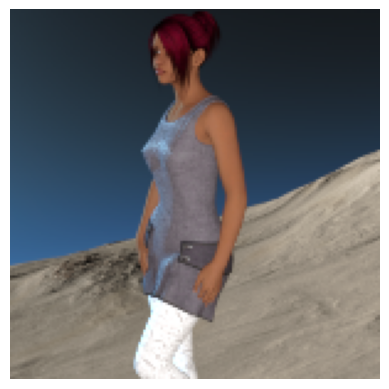

Label:  human
Previsão:  human
Probabilidade:  0.50332713


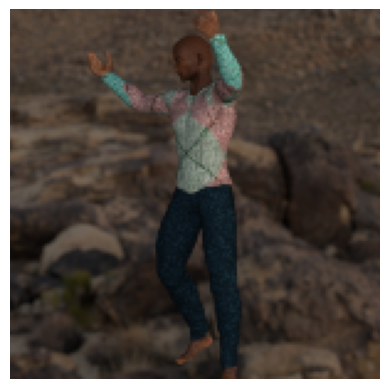

Label:  human
Previsão:  human
Probabilidade:  0.68560284


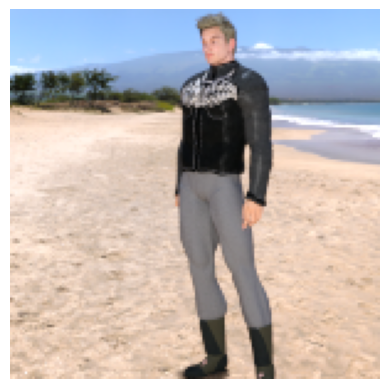

Label:  human
Previsão:  horse
Probabilidade:  0.41360784


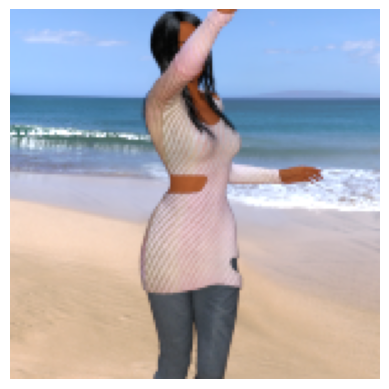

Label:  human
Previsão:  horse
Probabilidade:  0.24337341


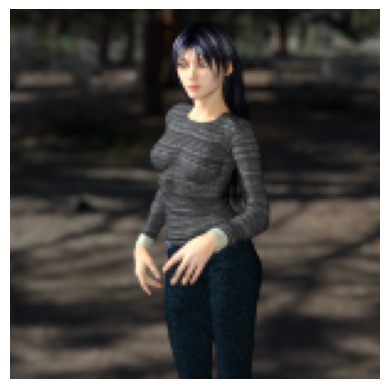

Label:  human
Previsão:  human
Probabilidade:  0.7437465


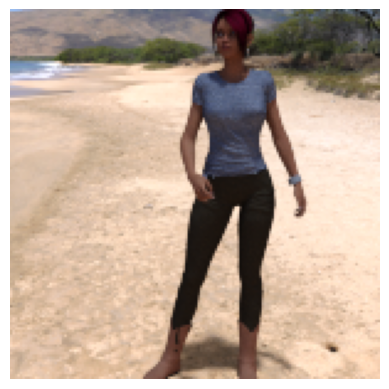

Label:  human
Previsão:  human
Probabilidade:  0.6806174


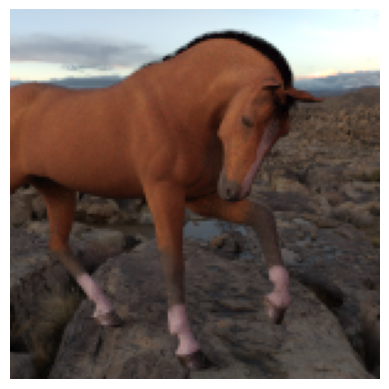

Label:  horse
Previsão:  human
Probabilidade:  0.5734269


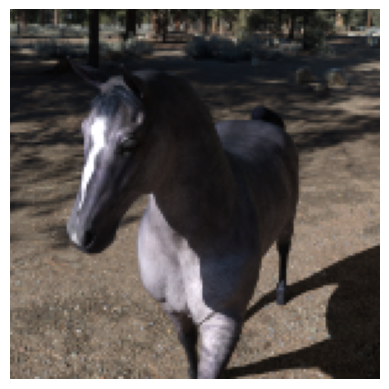

Label:  horse
Previsão:  horse
Probabilidade:  0.36011985


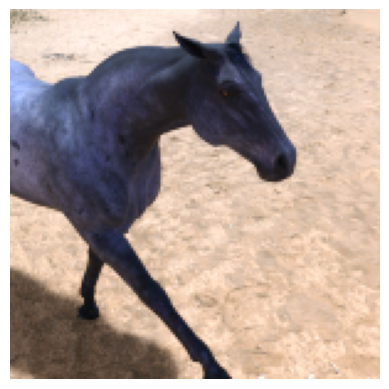

Label:  horse
Previsão:  horse
Probabilidade:  0.34014633


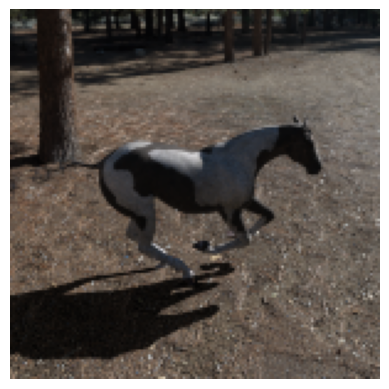

Label:  horse
Previsão:  human
Probabilidade:  0.59021026


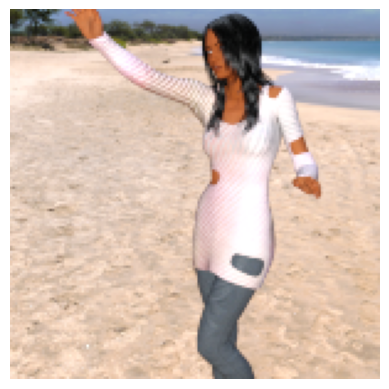

Label:  human
Previsão:  human
Probabilidade:  0.6263638


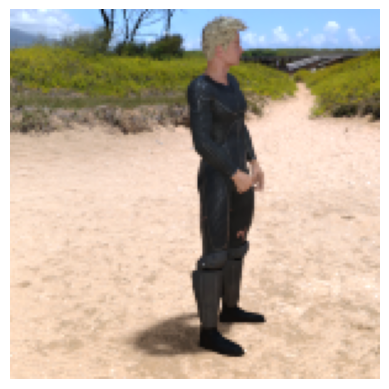

Label:  human
Previsão:  human
Probabilidade:  0.6202144


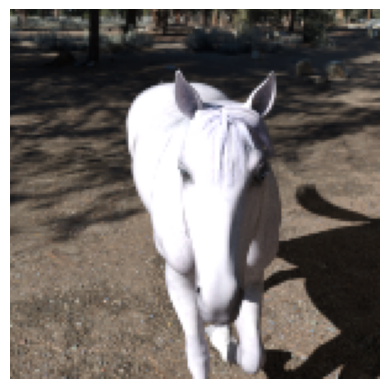

Label:  horse
Previsão:  human
Probabilidade:  0.6012703


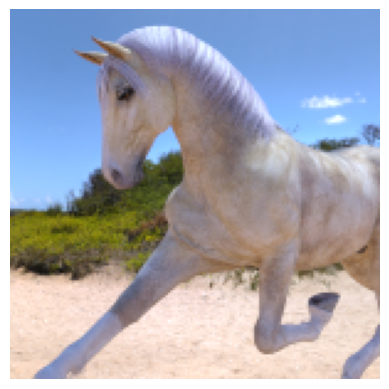

Label:  horse
Previsão:  horse
Probabilidade:  0.16956325


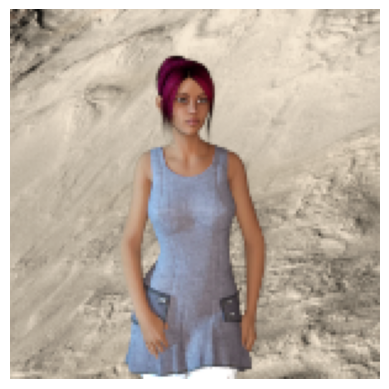

Label:  human
Previsão:  human
Probabilidade:  0.77125484


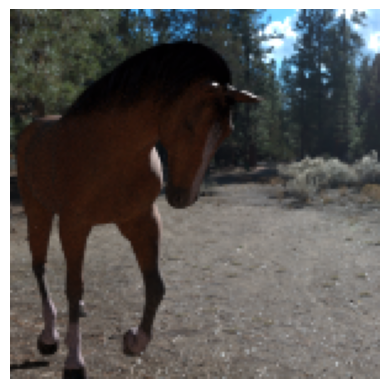

Label:  horse
Previsão:  horse
Probabilidade:  0.40544048


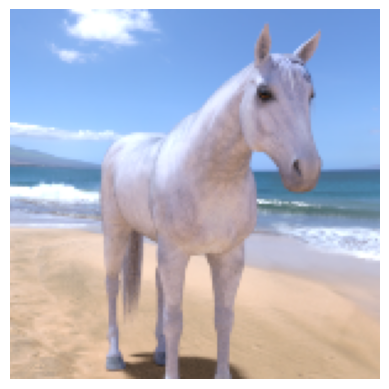

Label:  horse
Previsão:  horse
Probabilidade:  0.16971365


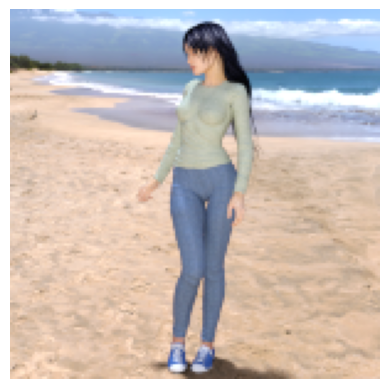

Label:  human
Previsão:  human
Probabilidade:  0.5078122


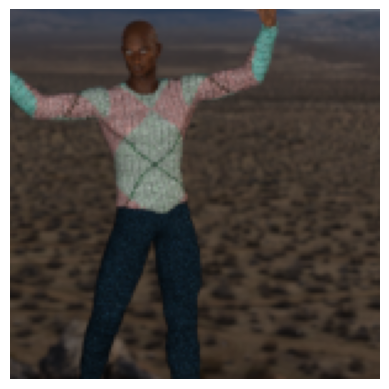

Label:  human
Previsão:  human
Probabilidade:  0.62885505


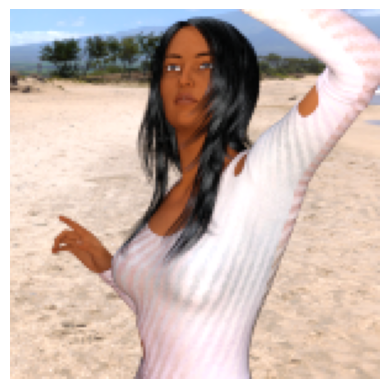

Label:  human
Previsão:  human
Probabilidade:  0.63337475


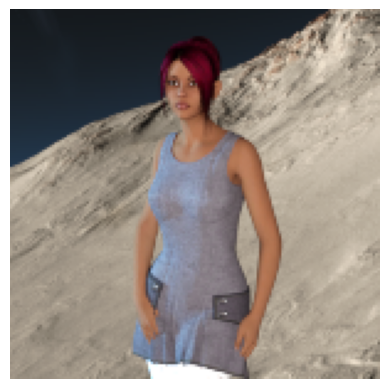

Label:  human
Previsão:  human
Probabilidade:  0.6811198


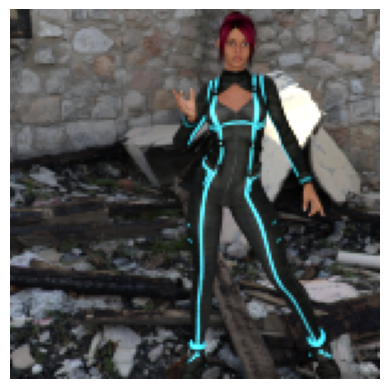

Label:  human
Previsão:  human
Probabilidade:  0.7741459


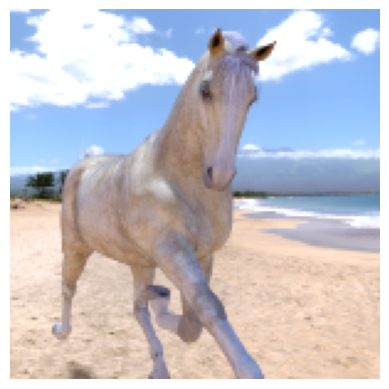

Label:  horse
Previsão:  horse
Probabilidade:  0.23543401


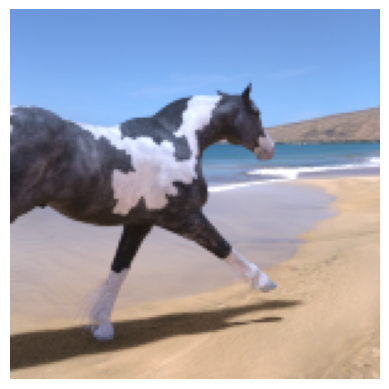

Label:  horse
Previsão:  horse
Probabilidade:  0.3055613


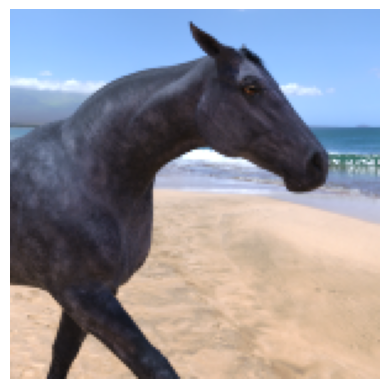

Label:  horse
Previsão:  horse
Probabilidade:  0.23061815


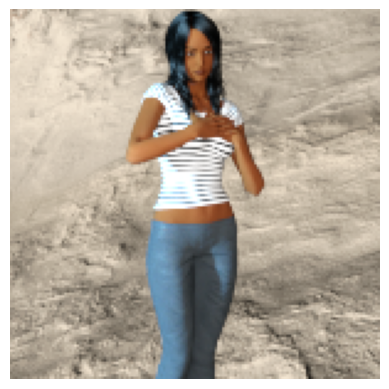

Label:  human
Previsão:  human
Probabilidade:  0.8690857


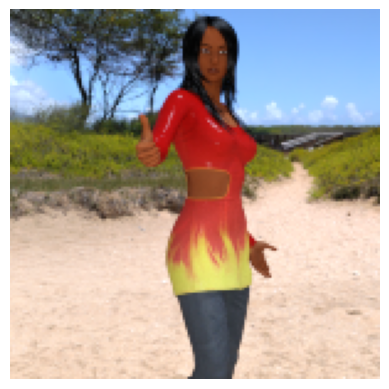

Label:  human
Previsão:  horse
Probabilidade:  0.32387304


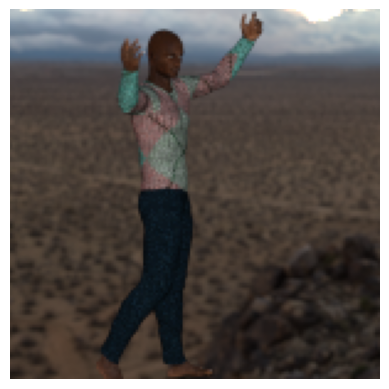

Label:  human
Previsão:  human
Probabilidade:  0.56158495


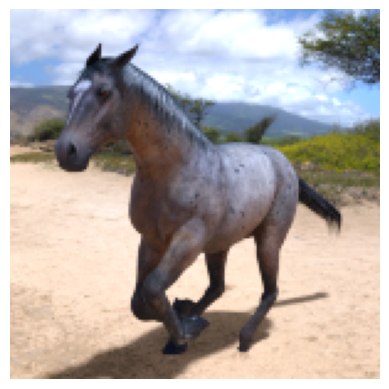

Label:  horse
Previsão:  horse
Probabilidade:  0.35829207


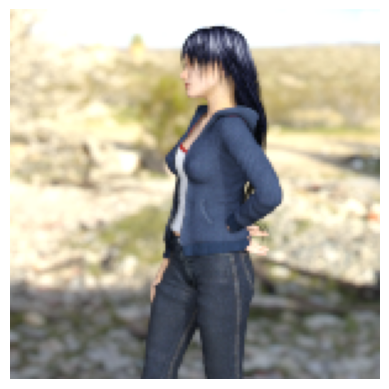

Label:  human
Previsão:  human
Probabilidade:  0.84669924


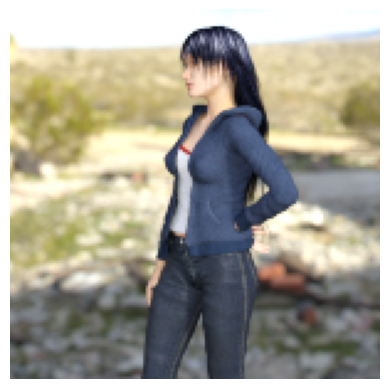

Label:  human
Previsão:  human
Probabilidade:  0.8480038


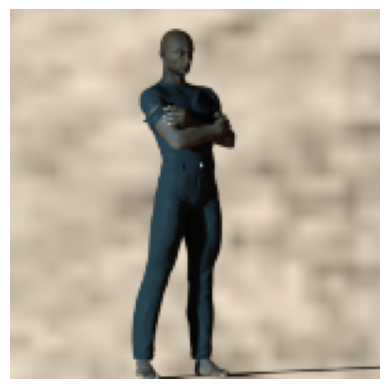

Label:  human
Previsão:  human
Probabilidade:  0.80897397


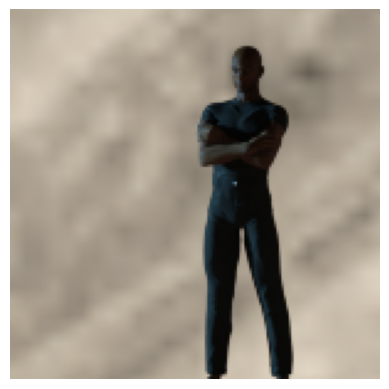

Label:  human
Previsão:  human
Probabilidade:  0.6525138


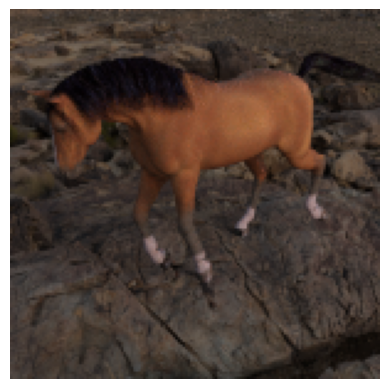

Label:  horse
Previsão:  human
Probabilidade:  0.59840626


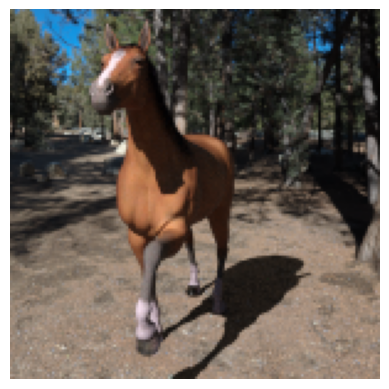

Label:  horse
Previsão:  horse
Probabilidade:  0.41947347


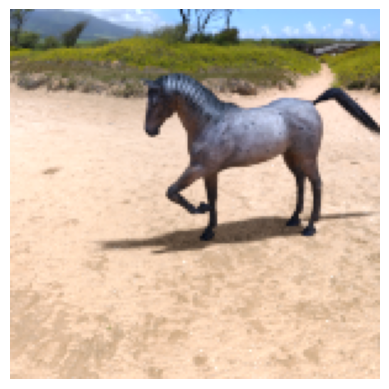

Label:  horse
Previsão:  human
Probabilidade:  0.61717385


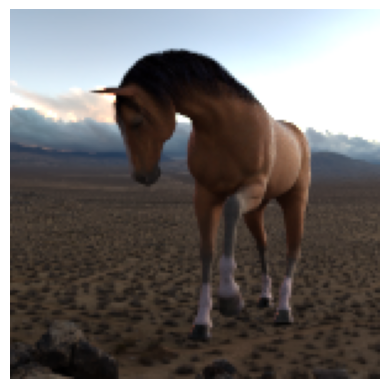

Label:  horse
Previsão:  horse
Probabilidade:  0.4460713


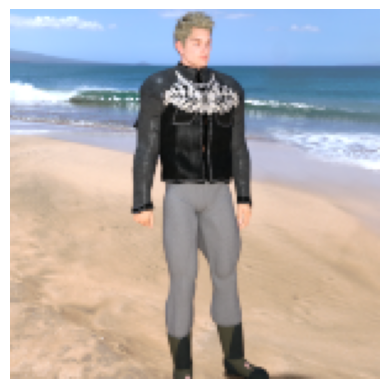

Label:  human
Previsão:  horse
Probabilidade:  0.34752348


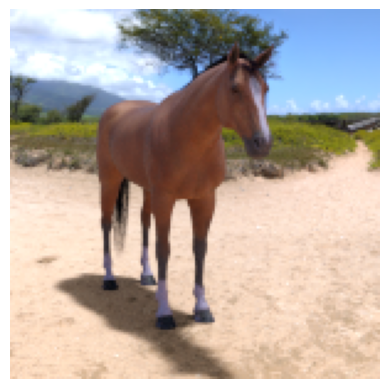

Label:  horse
Previsão:  horse
Probabilidade:  0.31415713


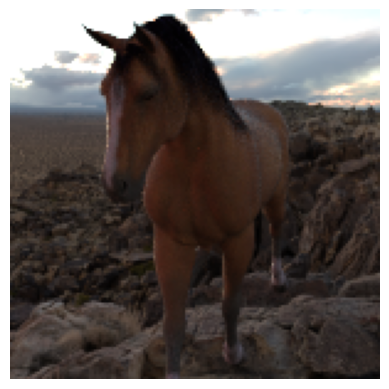

Label:  horse
Previsão:  horse
Probabilidade:  0.3917254


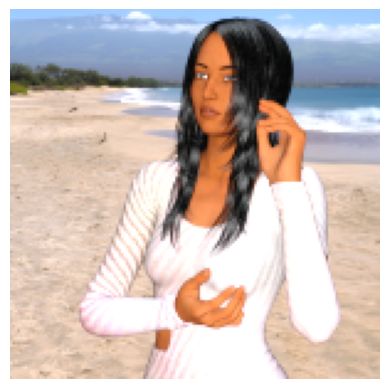

Label:  human
Previsão:  human
Probabilidade:  0.6169855


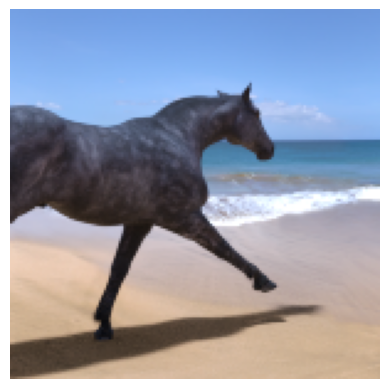

Label:  horse
Previsão:  horse
Probabilidade:  0.22605674


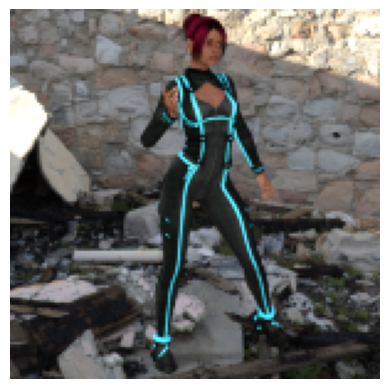

Label:  human
Previsão:  human
Probabilidade:  0.8663229


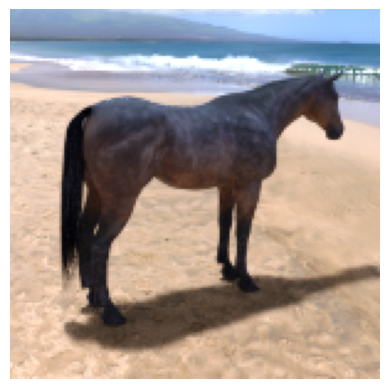

Label:  horse
Previsão:  horse
Probabilidade:  0.2746713


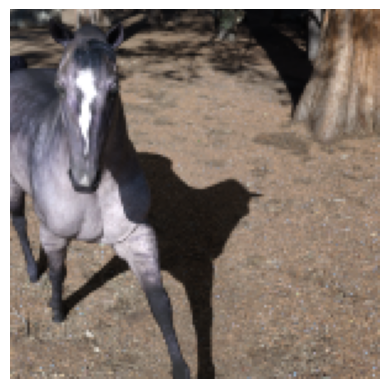

Label:  horse
Previsão:  horse
Probabilidade:  0.46530962


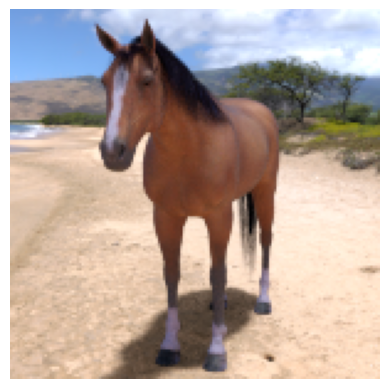

Label:  horse
Previsão:  horse
Probabilidade:  0.36036268


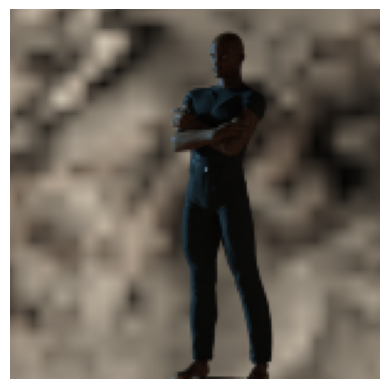

Label:  human
Previsão:  human
Probabilidade:  0.6407274


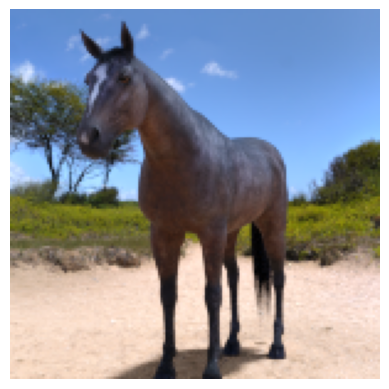

Label:  horse
Previsão:  horse
Probabilidade:  0.1544008


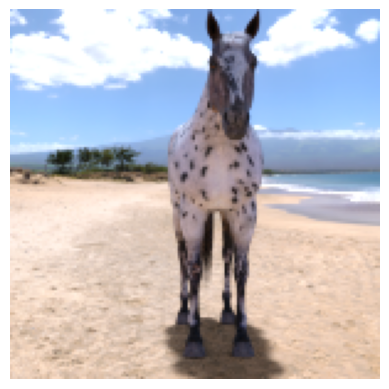

Label:  horse
Previsão:  horse
Probabilidade:  0.25885865


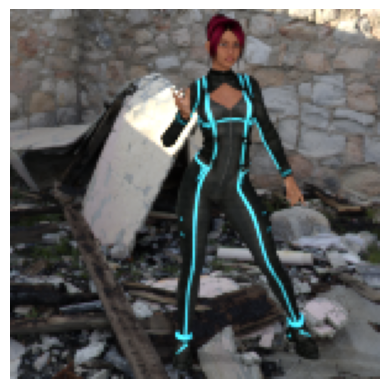

Label:  human
Previsão:  human
Probabilidade:  0.8672417


In [26]:
count = 0
y_pred = list()
y_true = list()
class_names = ['horse', 'human']

# Loop do data generator de teste que contem as imagens
for batch in test_generator:

    count+=1

    # Condição de saída do loop. Só executaremos o modelo em algumas imagens
    if count == 2:
        break

    else:

        # Pegando a imagem e o label
        images = batch[0]
        labels = batch[1]

        # Previsão
        predictions = model.predict(images)

        # Visualização da imagem
        for i in range(len(images)):

            image = images[i]
            label = labels[i]
            prediction = predictions[i]

            # Converte o array de previsão para visualizar a classe e a probabilidade
            predicted_class = np.argmax(prediction)
            probability = prediction[predicted_class]
            label = class_names[int(label)]
            y_true.append(label)

            # Faz o DE-PARA da probabilidade com o tipo de classe da previsão
            class_name = 'human' if prediction >= 0.5 else 'horse'
            y_pred.append(class_name)

            # Configura a saída das imagens que serão visualizadas
            plt.imshow(images[i])
            plt.axis('Off')
            plt.show()

            # Imprime os resultados da classificação das images
            print("Label: ", label)
            print("Previsão: ", class_name)
            print("Probabilidade: ", probability)


# 6 - Avaliação do modelo de deep learning

Acurácia do modelo nos dados de teste

In [27]:
loss, accuracy = model.evaluate_generator(test_generator)
print("Test: accuracy = %f  ;  loss = %f " % (accuracy, loss))

<ipython-input-27-78954c843b8c>:1: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  loss, accuracy = model.evaluate_generator(test_generator)


Test: accuracy = 0.851133  ;  loss = 0.445744 


Métricas de performance do modelo no subconjunto das imagens de teste

In [28]:
accuracy = skm.accuracy_score(y_true, y_pred)
precision = skm.precision_score(y_true, y_pred, average='weighted')
recall = skm.recall_score(y_true, y_pred, average='weighted')
f1score = skm.f1_score(y_true, y_pred, average='weighted')

print("Accuracy: ", accuracy)
print("Precision: ", precision)
print("Recall: ", recall)
print("F1 Score: ", f1score)

Accuracy:  0.82
Precision:  0.8202254428341385
Recall:  0.82
F1 Score:  0.8197832195905258


Matriz de confusão para identificar onde o modelo de deep learning acertou e errou na classificação do subconjunto de imagens de teste



Matriz de confusão sem normalização


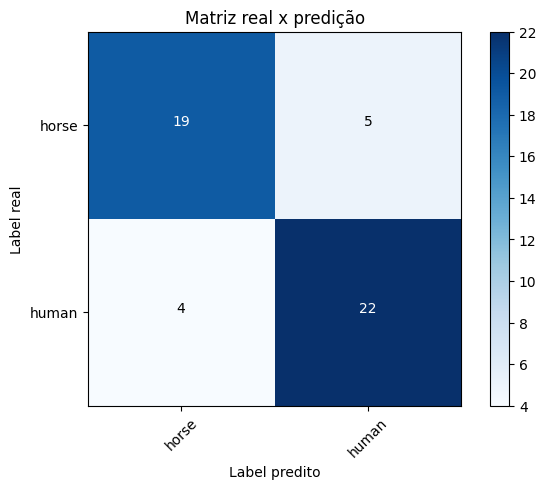

In [29]:
cnf_matrix = confusion_matrix(y_true, y_pred, labels=class_names)
np.set_printoptions(precision=2)

plt.figure()
plot_confusion_matrix(cnf_matrix,
                      classes=['horse',
                               'human'],
                      normalize= False,
                      title='Matriz real x predição')

# 7 - Exportação do modelo de deep learning para posterior uso

Salvando o modelo de deep learning que foi treinado



In [30]:
# obtendo a data e hora atual
now = datetime.now()

# Definição do formato
format = '%Y-%m-%dT%H%M'

# Converter a data e hora em uma string com o formato especificado
formatted_datetime = now.strftime(format)

path_model = 'datasets/trained_models'

name_model = 'trained_model_' + formatted_datetime + '.h5'

# salvando o modelo
model.save("%s/%s" % (path_model, name_model))
print("Modelo salvo com o nome: ", name_model)

Modelo salvo com o nome:  trained_model_2023-07-20T0419.h5


# 8 - Teste do modelo

Carregando o modelo salvo



In [31]:
loaded_model = keras.models.load_model("%s/%s" % (path_model, name_model))
print("Modelo %s carregado com sucesso" % (name_model))

Modelo trained_model_2023-07-20T0419.h5 carregado com sucesso


Execução do modelo em um subconjunto de imagens de teste



2/2 [==============================] - 1s 227ms/step


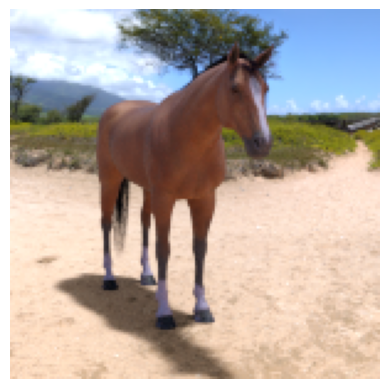

Label:  horse
Previsão:  horse
Probabilidade:  0.31415713


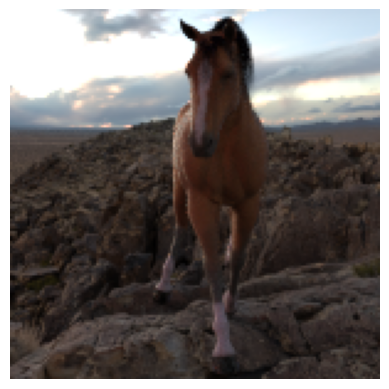

Label:  horse
Previsão:  human
Probabilidade:  0.5289675


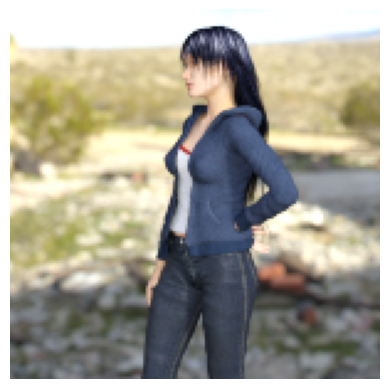

Label:  human
Previsão:  human
Probabilidade:  0.8480038


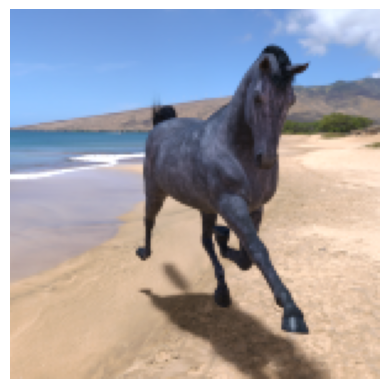

Label:  horse
Previsão:  horse
Probabilidade:  0.2261708


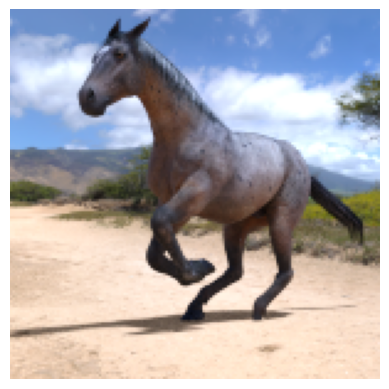

Label:  horse
Previsão:  horse
Probabilidade:  0.25215772


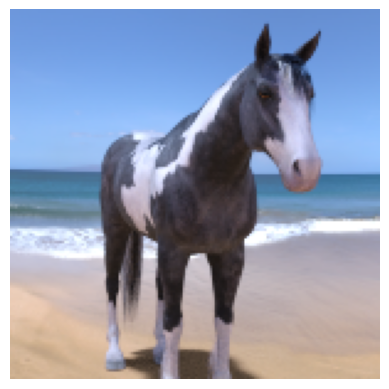

Label:  horse
Previsão:  horse
Probabilidade:  0.25104007


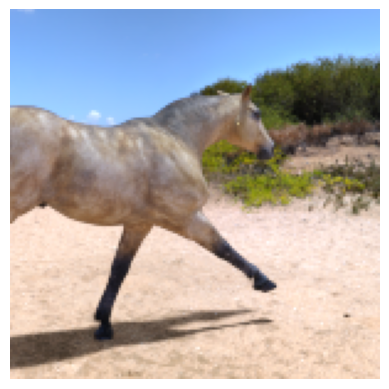

Label:  horse
Previsão:  horse
Probabilidade:  0.19941941


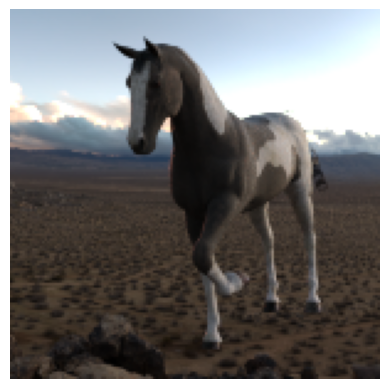

Label:  horse
Previsão:  horse
Probabilidade:  0.43070534


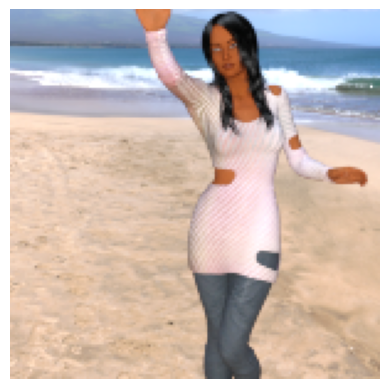

Label:  human
Previsão:  horse
Probabilidade:  0.4577619


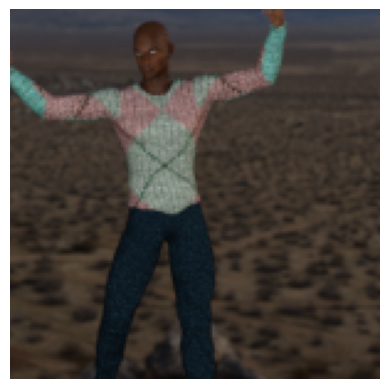

Label:  human
Previsão:  human
Probabilidade:  0.65119576


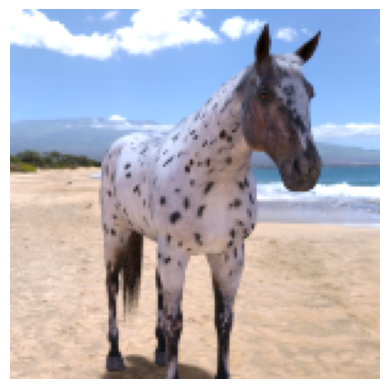

Label:  horse
Previsão:  horse
Probabilidade:  0.20524636


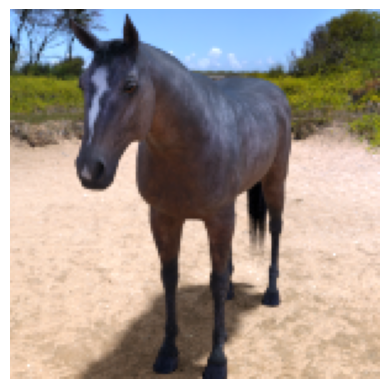

Label:  horse
Previsão:  horse
Probabilidade:  0.26138008


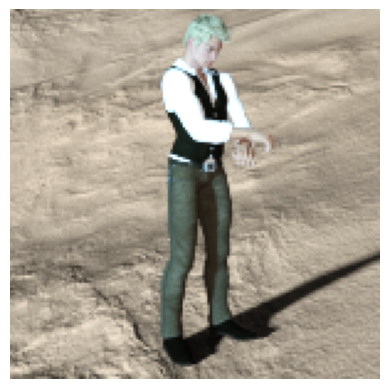

Label:  human
Previsão:  human
Probabilidade:  0.85408366


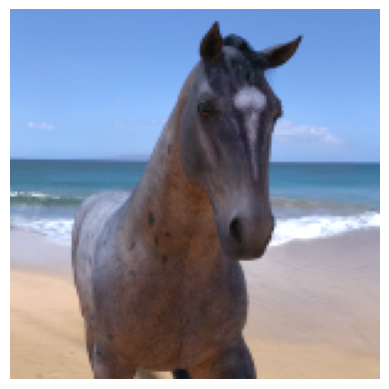

Label:  horse
Previsão:  horse
Probabilidade:  0.1480452


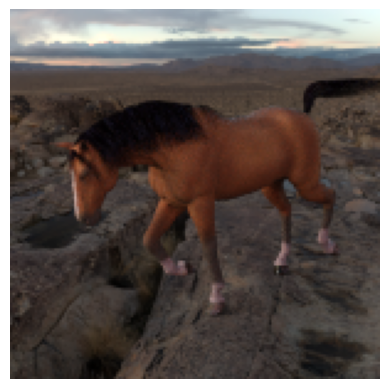

Label:  horse
Previsão:  horse
Probabilidade:  0.46057394


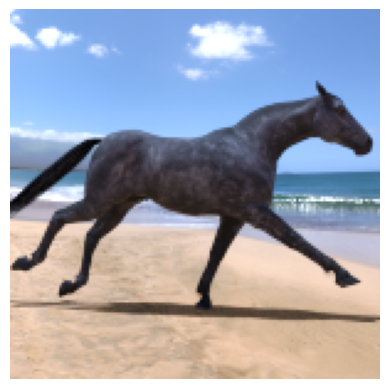

Label:  horse
Previsão:  horse
Probabilidade:  0.13192604


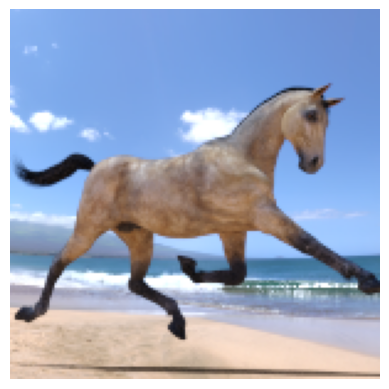

Label:  horse
Previsão:  horse
Probabilidade:  0.17486052


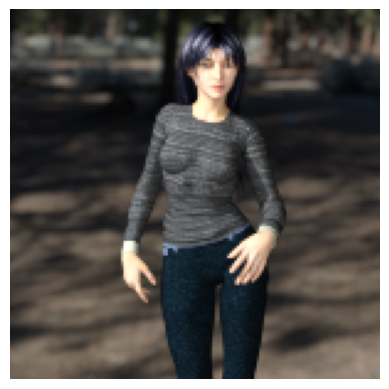

Label:  human
Previsão:  human
Probabilidade:  0.7206292


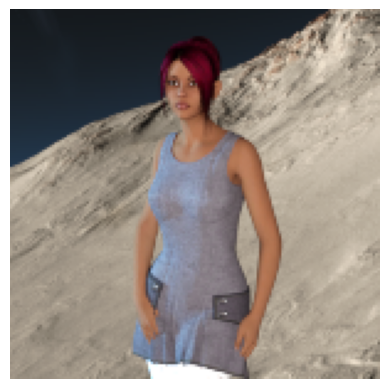

Label:  human
Previsão:  human
Probabilidade:  0.6811198


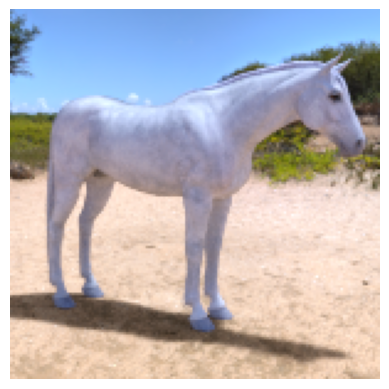

Label:  horse
Previsão:  horse
Probabilidade:  0.1980524


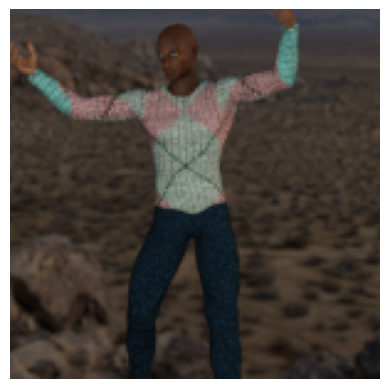

Label:  human
Previsão:  human
Probabilidade:  0.6660977


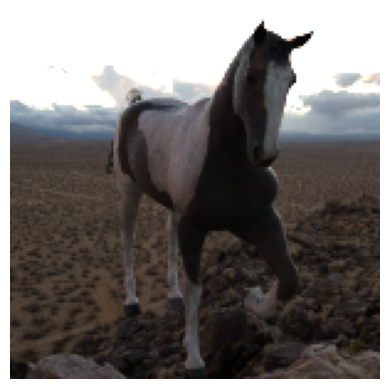

Label:  horse
Previsão:  horse
Probabilidade:  0.48451552


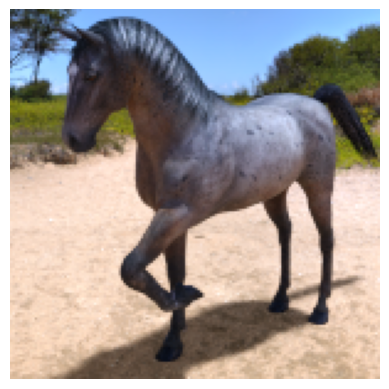

Label:  horse
Previsão:  horse
Probabilidade:  0.27212372


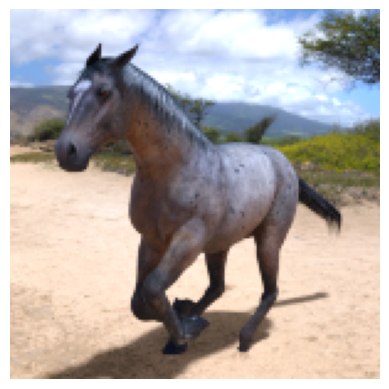

Label:  horse
Previsão:  horse
Probabilidade:  0.35829207


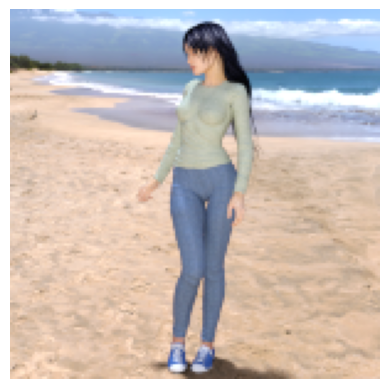

Label:  human
Previsão:  human
Probabilidade:  0.5078122


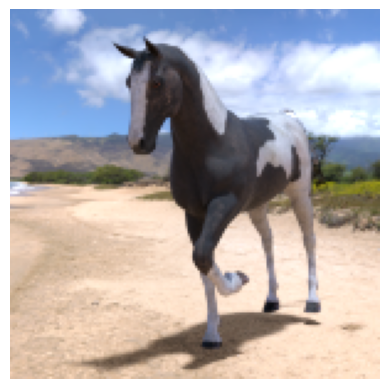

Label:  horse
Previsão:  horse
Probabilidade:  0.2684419


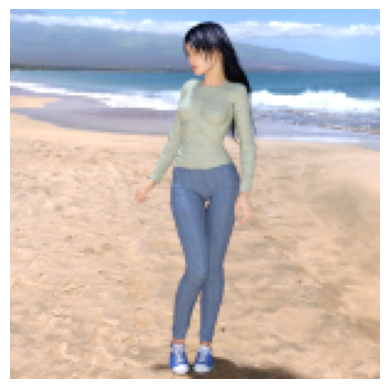

Label:  human
Previsão:  horse
Probabilidade:  0.46781182


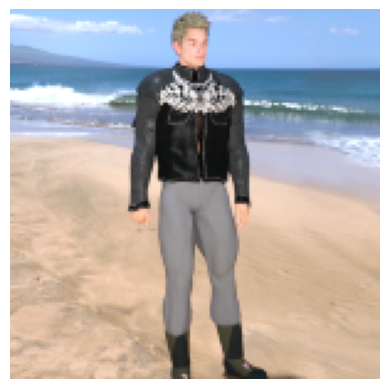

Label:  human
Previsão:  horse
Probabilidade:  0.3686841


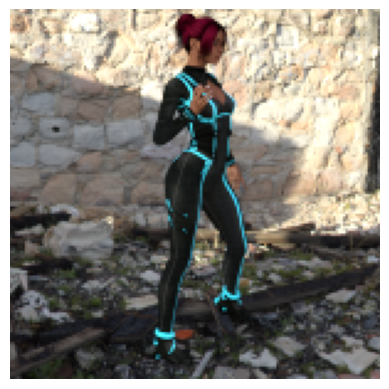

Label:  human
Previsão:  human
Probabilidade:  0.8749673


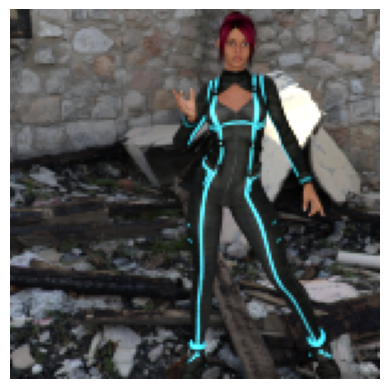

Label:  human
Previsão:  human
Probabilidade:  0.7741459


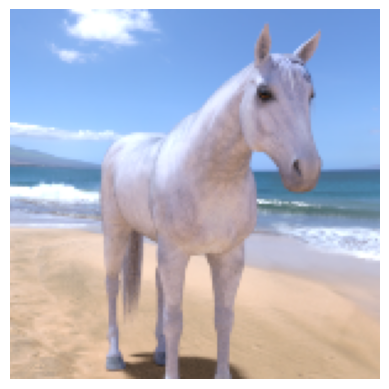

Label:  horse
Previsão:  horse
Probabilidade:  0.16971365


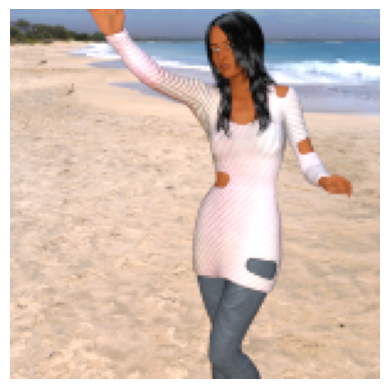

Label:  human
Previsão:  human
Probabilidade:  0.5777162


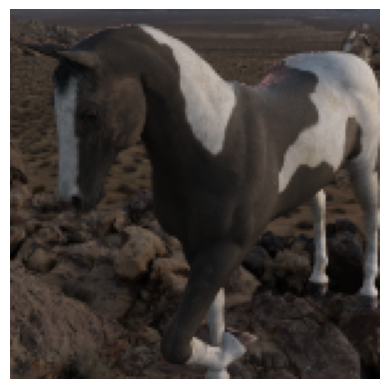

Label:  horse
Previsão:  human
Probabilidade:  0.5044544


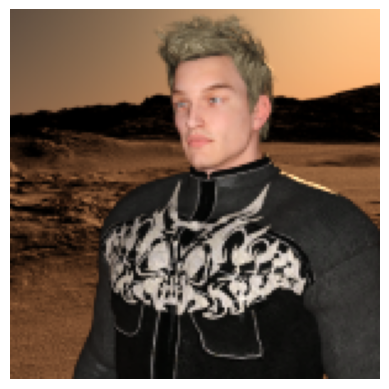

Label:  human
Previsão:  human
Probabilidade:  0.7887346


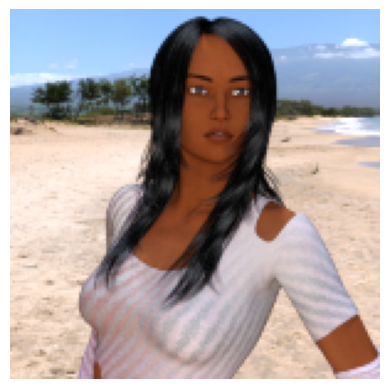

Label:  human
Previsão:  horse
Probabilidade:  0.40791497


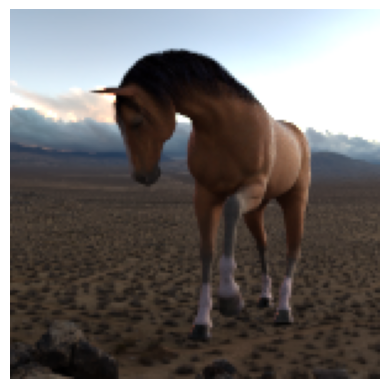

Label:  horse
Previsão:  horse
Probabilidade:  0.4460713


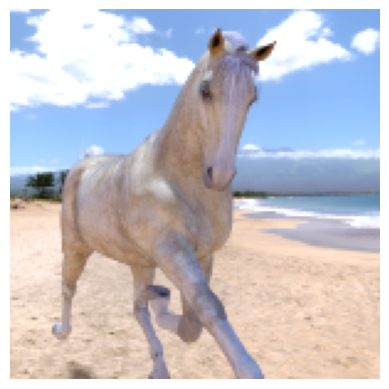

Label:  horse
Previsão:  horse
Probabilidade:  0.23543401


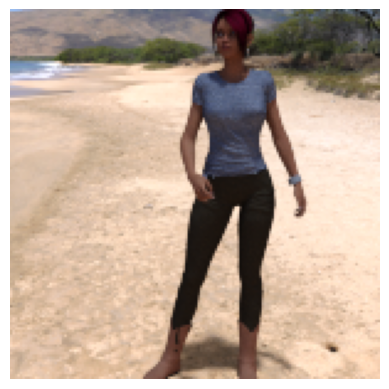

Label:  human
Previsão:  human
Probabilidade:  0.6806174


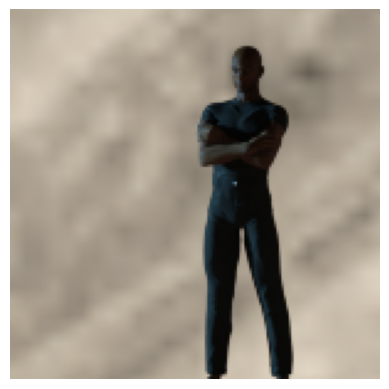

Label:  human
Previsão:  human
Probabilidade:  0.6525138


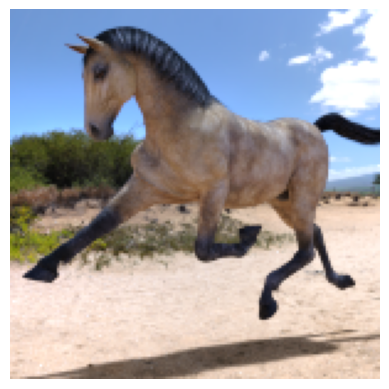

Label:  horse
Previsão:  horse
Probabilidade:  0.1630652


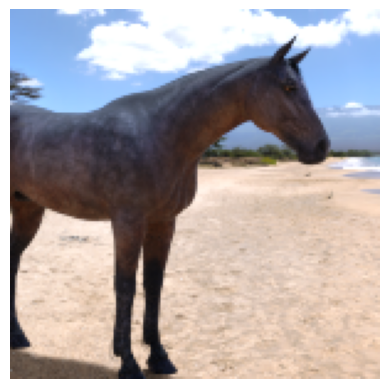

Label:  horse
Previsão:  horse
Probabilidade:  0.2376145


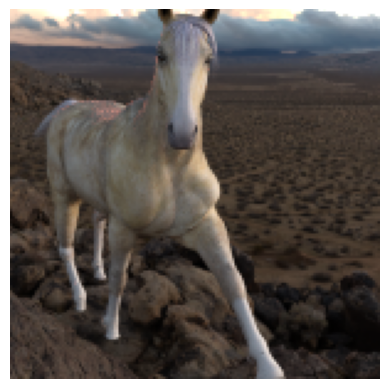

Label:  horse
Previsão:  human
Probabilidade:  0.50800997


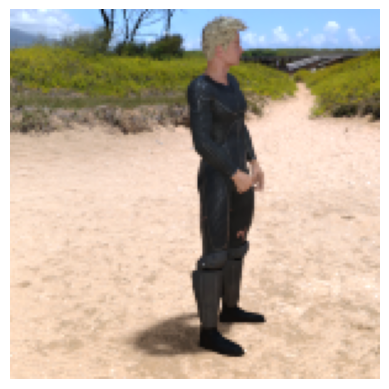

Label:  human
Previsão:  human
Probabilidade:  0.6202144


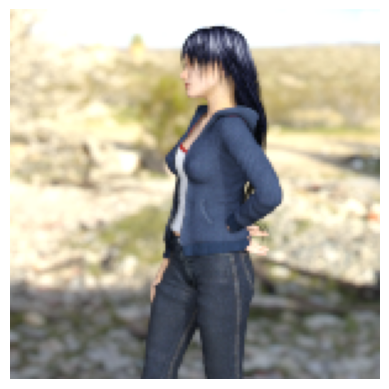

Label:  human
Previsão:  human
Probabilidade:  0.84669924


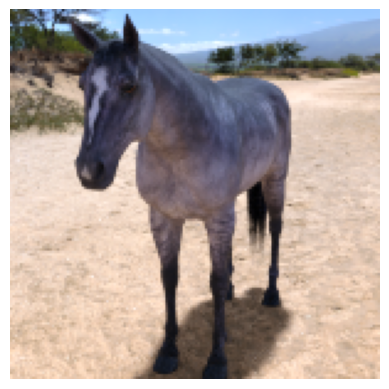

Label:  horse
Previsão:  horse
Probabilidade:  0.31812218


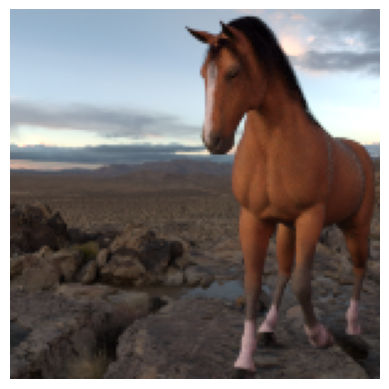

Label:  horse
Previsão:  horse
Probabilidade:  0.47746116


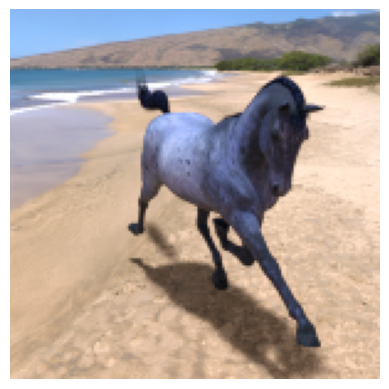

Label:  horse
Previsão:  human
Probabilidade:  0.59948385


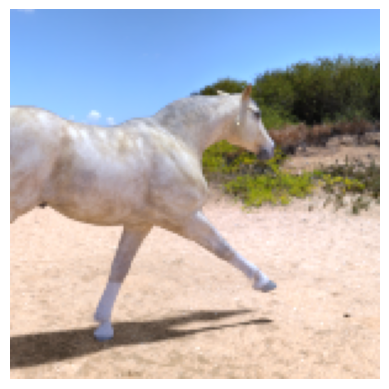

Label:  horse
Previsão:  horse
Probabilidade:  0.21393456


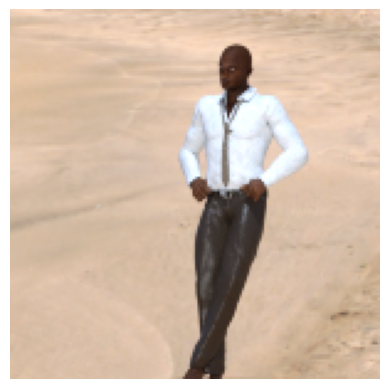

Label:  human
Previsão:  human
Probabilidade:  0.73007


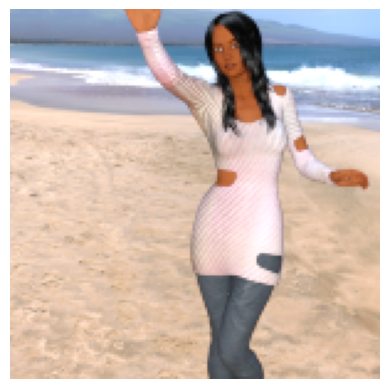

Label:  human
Previsão:  horse
Probabilidade:  0.4804686


In [32]:
count = 0
y_pred = list()
y_true = list()
class_names = ['horse', 'human']

# Loop do data generator de teste que contem as imagens
for batch in test_generator:

    count+=1

    # Condição de saída do loop. Só executaremos o modelo em algumas imagens
    if count == 2:
        break

    else:

        # Pegando a imagem e o label
        images = batch[0]
        labels = batch[1]

        # Previsão
        predictions = loaded_model.predict(images)

        # Visualização da imagem
        for i in range(len(images)):

            image = images[i]
            label = labels[i]
            prediction = predictions[i]

            # Converte o array de previsão para visualizar a classe e a probabilidade
            predicted_class = np.argmax(prediction)
            probability = prediction[predicted_class]
            label = class_names[int(label)]
            y_true.append(label)

            # Faz o DE-PARA da probabilidade com o tipo de classe da previsão
            class_name = 'human' if prediction >= 0.5 else 'horse'
            y_pred.append(class_name)

            # Configura a saída das imagens que serão visualizadas
            plt.imshow(images[i])
            plt.axis('Off')
            plt.show()

            # Imprime os resultados da classificação das images
            print("Label: ", label)
            print("Previsão: ", class_name)
            print("Probabilidade: ", probability)